### Setting and Import

In [1]:
# !pip install -q -U tensorflow==2.15.1
# !pip install -q -U keras_cv

In [2]:
import keras_cv
import tensorflow as tf
from utils import *
from constants import *

In [5]:
try:
    gpus = tf.config.list_physical_devices('GPU')
    if gpus:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
            print("Found GPU:", gpu)
        strategy = tf.distribute.MirroredStrategy(devices=None)
    else:
        print("GPU not found.")
        strategy = tf.distribute.get_strategy()
except RuntimeError as e:
    print(e)

print("REPLICAS:", strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.AUTOTUNE

Found GPU: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
REPLICAS: 1


## Prompt and Model

In [6]:
# prompt with unique_id
prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} by the sea"
print(prompt)

a photo of miru cat by the sea


In [1]:
# Initialize Stable Diffusion model
dreambooth_model = keras_cv.models.StableDiffusion(img_width=RESOLUTION, img_height=RESOLUTION, jit_compile=True)

**prompt**: A text description that guides the model to generate images with specific content.

**batch_size**: Specifies the number of images to be generated.

**num_steps**: Specifies the number of optimization steps to be performed during the generation process. The model attempts to improve the image at each step to better match the prompt. Increasing num_steps can enhance image quality but will also increase the generation time.

**unconditional_guidance_scale (UGS)**: Adjusts the degree of reliance on the prompt during image generation. A higher UGS value means that the generated images will more closely follow the prompt's instructions, usually at the expense of lower image quality, while a lower value allows the model more freedom to interpret the prompt.

## Model 1

learning_rate = 1e-6, max_train_steps = 600

loss of final epoch: 0.1269

In [ ]:
# learning_rate = 1e-6, max_train_steps = 600
# load weights
ckpt_path = f"{PATH}/weights/weights_1e-06_600.h5"
dreambooth_model.diffusion_model.load_weights(ckpt_path)

3439090152/3439090152 [==============================] - 13s 0us/step


30/30 [==============================] - 7s 225ms/step


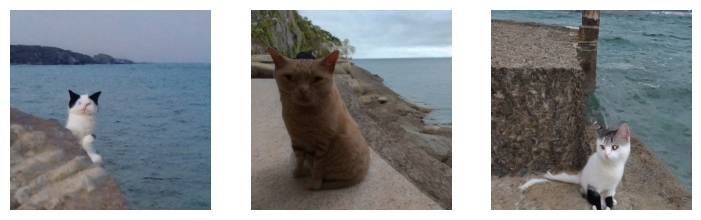

30/30 [==============================] - 7s 225ms/step


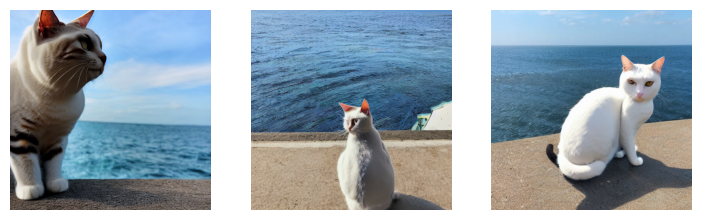

50/50 [==============================] - 11s 225ms/step


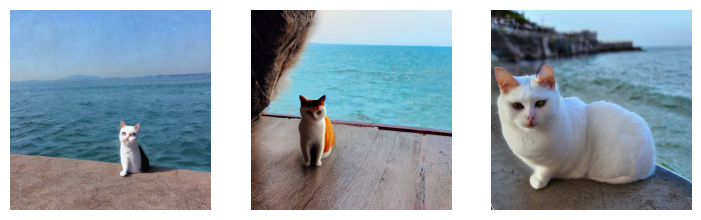

In [ ]:
# set batch_size = 3, generate 3 images
num_img_gen = 3
# set num_steps and unconditional_guidance_scale pairs
steps_ugs_pairs = [(30, 6), (30, 12), (50, 12)]
# generate images sequentially according to steps_ugs_pairs
for steps, ugs in steps_ugs_pairs:
    images = dreambooth_model.text_to_image(prompt, batch_size=num_img_gen, num_steps=steps, unconditional_guidance_scale=ugs)
    plot_images(images)

In the above image generation, the arrangement of images in each row is according to the settings of **num_steps** and **unconditional_guidance_scale** as follows: **(30, 6), (30, 12), (50, 12)**. 

Based on the definition of these parameters, it is expected that increasing **num_steps** can improve image quality, while increasing **UGS** can enhance the dependency on the prompt. Since the instance image is a white cat, the goal is to increase both the fidelity of the instance image (converting from a class image to a white cat) and the image quality.

## Model 2

learning_rate = 1e-6, max_train_steps = 900

loss of final epoch: 0.1128

In [ ]:
# learning_rate = 1e-6, max_train_steps = 900
ckpt_path = f"{PATH}/weights/weights_1e-06_900.h5"
dreambooth_model.diffusion_model.load_weights(ckpt_path)

30/30 [==============================] - 7s 223ms/step


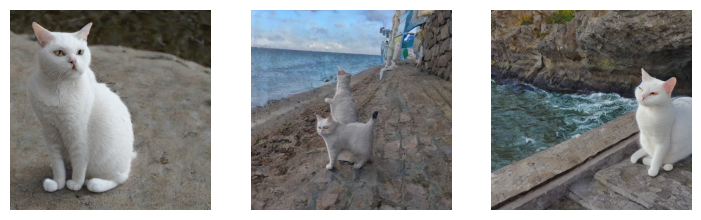

30/30 [==============================] - 7s 225ms/step


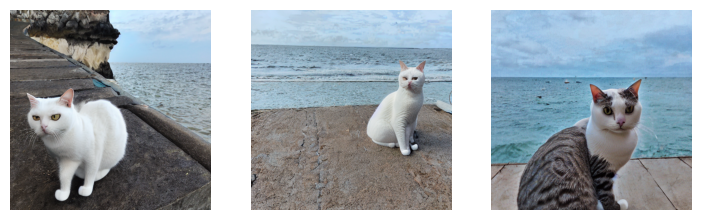

50/50 [==============================] - 11s 224ms/step


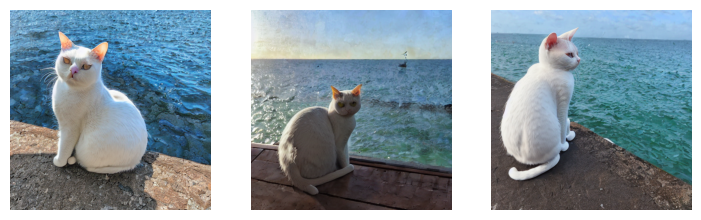

In [ ]:
# images for each row with (steps, gus) set to (30, 6), (30, 12), (50, 12) sequentially
for steps, ugs in steps_ugs_pairs:
    images = dreambooth_model.text_to_image(prompt, batch_size=num_img_gen, num_steps=steps, unconditional_guidance_scale=ugs)
    plot_images(images)

Compared to model 1 trained with steps=600, **model 2** trained with steps=900 shows a noticeable improvement in instance image fidelity.

## Model 3

learning_rate = 3e-6, max_train_steps = 600

loss of final epoch: 0.1030

In [ ]:
# learning_rate = 3e-6, max_train_steps = 600
ckpt_path = f"{PATH}/weights/weights_3e-06_600.h5"
dreambooth_model.diffusion_model.load_weights(ckpt_path)

30/30 [==============================] - 7s 223ms/step


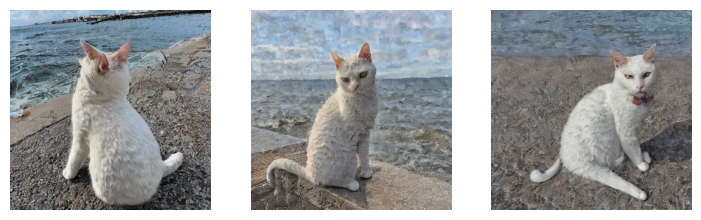

30/30 [==============================] - 7s 224ms/step


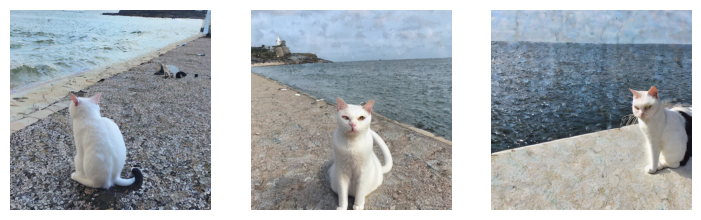

50/50 [==============================] - 11s 224ms/step


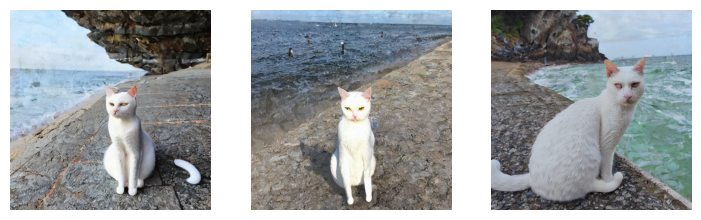

In [ ]:
# images for each row with (steps, gus) set to (30, 6), (30, 12), (50, 12) sequentially
for steps, ugs in steps_ugs_pairs:
    images = dreambooth_model.text_to_image(prompt, batch_size=num_img_gen, num_steps=steps, unconditional_guidance_scale=ugs)
    plot_images(images)

During the training process, it was observed that using a learning rate of 3e-6 is more appropriate for this task than 1e-6. Compared to models 1 and 2, **model 3** learns the instance image better, with a noticeable increase in the proportion of the white cat. The images generated are consistent with the results obtained during the training process.

## Model 4

learning_rate = 3e-6, max_train_steps = 900

loss of final epoch: 0.0894

In [8]:
# learning_rate = 3e-6, max_train_steps = 900
ckpt_path = f"{PATH}/weights/weights_3e-06_900.h5"
dreambooth_model.diffusion_model.load_weights(ckpt_path)

30/30 [==============================] - 7s 222ms/step


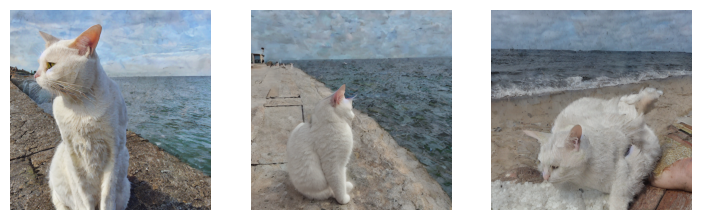

30/30 [==============================] - 7s 223ms/step


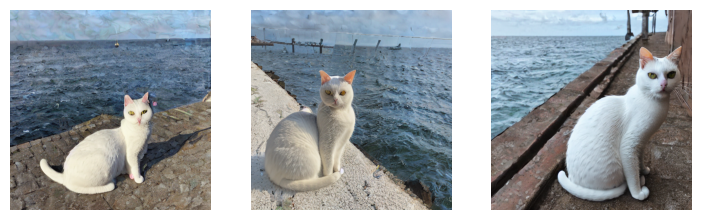

50/50 [==============================] - 11s 223ms/step


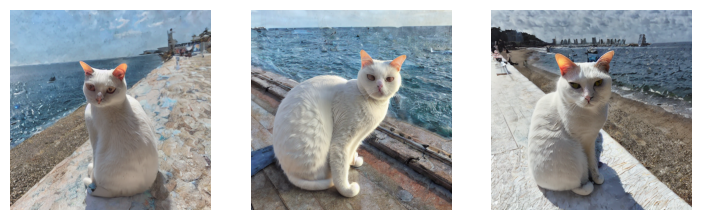

In [ ]:
# images for each row with (steps, gus) set to (30, 6), (30, 12), (50, 12) sequentially
for steps, ugs in steps_ugs_pairs:
    images = dreambooth_model.text_to_image(prompt, batch_size=num_img_gen, num_steps=steps, unconditional_guidance_scale=ugs)
    plot_images(images)

Compared to model 3, **model 4** with max_train_steps of 900 shows a slight improvement, making it the best model obtained at this stage. Using different settings for steps and ugs still maintains a certain fidelity of the instance image.

30/30 [==============================] - 7s 224ms/step


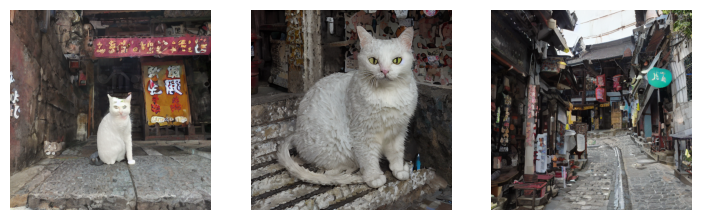

30/30 [==============================] - 7s 223ms/step


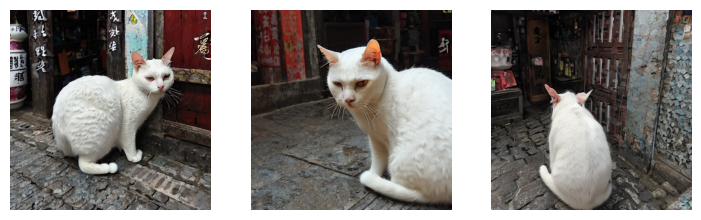

50/50 [==============================] - 11s 223ms/step


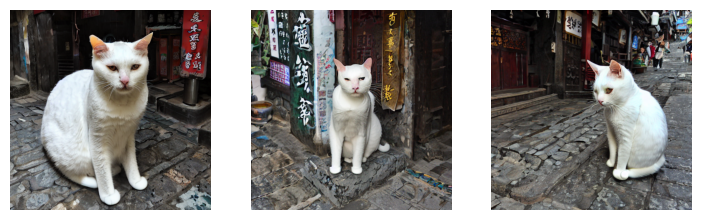

In [ ]:
# new prompt: "a photo of miru cat in Juifen"
prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} in Jiufen"

# images for each row with (steps, gus) set to (30, 6), (30, 12), (50, 12) sequentially
for steps, ugs in steps_ugs_pairs:
    images = dreambooth_model.text_to_image(prompt, batch_size=num_img_gen, num_steps=steps, unconditional_guidance_scale=ugs)
    plot_images(images)

Try generating images using a new prompt for a different scene.

In [2]:
# generate more images from model 4
save_folder = f'{PATH}/generated_by_3e-06_900'
generate_and_save_images(save_folder, dreambooth_model, prompt, 10, 1, 50, 12)


## Brief Summary

| Model   | Learning Rate    | Max Train Steps | Loss of Final Epoch |
|---------|------------------|-----------------|---------------------|
| Model 1 | 1e-6  | 600             | 0.1269              |
| Model 2 | 1e-6  | 900             | 0.1128              |
| Model 3 | 3e-6  | 600             | 0.1030              |
| Model 4 | 3e-6  | 900             | 0.0894              |

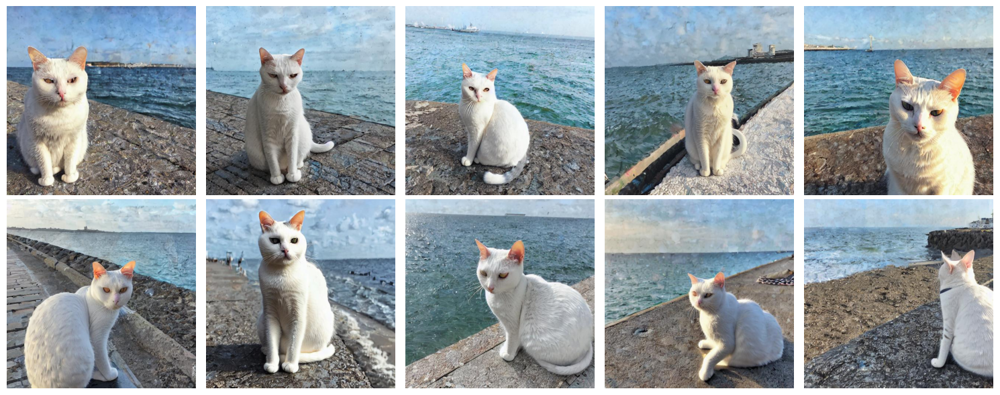

In [7]:
# display the generated images from model 4
images_3e_06_900 = list(paths.list_images(save_folder))
plot_images(load_images(images_3e_06_900[:10]))

For the model and dataset of this task, using a **learning rate of 3e-6** and **max_train_steps of 900** results in a better model. 

After experimenting with different combinations of num_steps and unconditional_guidance_scale values, **steps, ugs = 50, 12** is able to generate images that are not overfitted and achieve a suitable balance between instance image fidelity and image quality.

Subsequently, further adjustments can be attempted on additional parameters and fine-tuning of the text encoder to make the model more suitable for this task.

-- continue after submission --

## Schedulers

learning_rate = 3e-6 <br>
max_train_steps = 1200 <br>
beta_schedule='linear'<br>
steps=55, ups=13 <br>
with different variance_type settigs <br><br>

In this task, the model with variance_type set to 'fixed_small_log' or 'learned' performs slightly better than the other two options. The beta_schedule set to 'scaled_linear' is considerably worse than 'linear', therefore I stopped using it.

### variance_type = 'fixed_small'

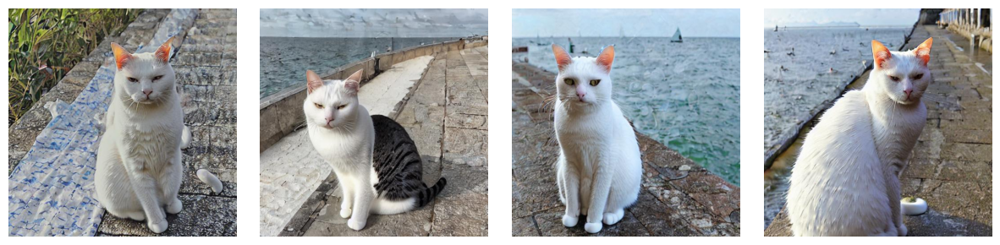

In [8]:
# variance_type = 'fixed_small'
# negative_prompt = None
images_paths = list(paths.list_images('images_linear_small_3e-06_1200/sea'))
plot_images(load_images(images_paths[:4]))

### variance_type = 'fixed_small_log'

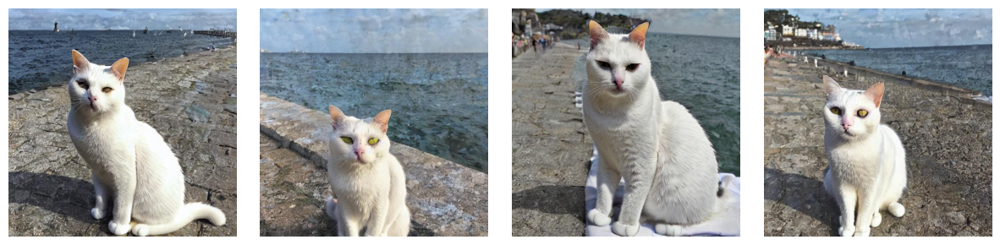

In [10]:
# variance_type = 'fixed_small_log'
# negative_prompt = None
images_paths = list(paths.list_images('images_linear_small_log_3e-06_1200/sea'))
plot_images(load_images(images_paths[:4]))

### variance_type = 'learned_range'

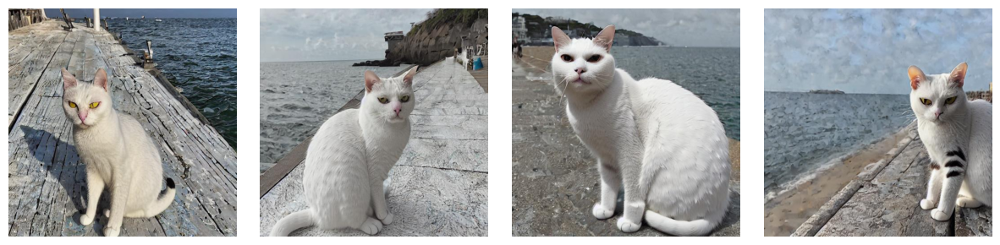

In [24]:
# variance_type = 'learned_range'
# negative_prompt = None
images_paths = list(paths.list_images('images_linear_learned_range_3e-06_1200/sea'))
plot_images(load_images(images_paths[:4]))

**negative_prompt** <br><br>
tail cut off, multiple tails, multiple ears, multiple legs, <br>
tail not attached to the body, incorrect placement of tail, legs and ears

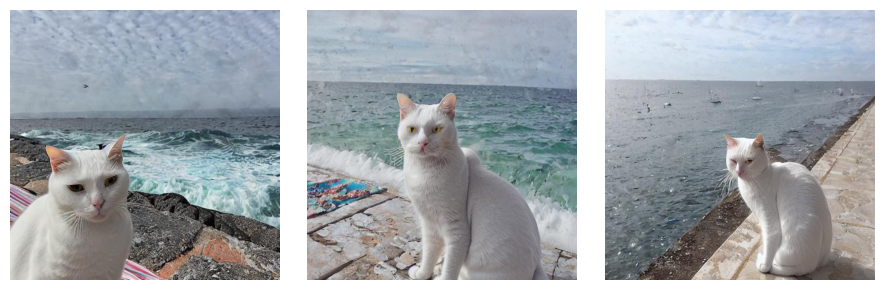

In [22]:
# variance_type = 'learned_range'
# with negative_prompt
images_paths = list(paths.list_images('images_linear_learned_range_3e-06_1200/sea_neg'))
plot_images(load_images(images_paths[:3]))

Setting a negative_prompt can restrict unwanted elements, but it may degrade image quality and instance fidelity.

### variance_type = 'learned'

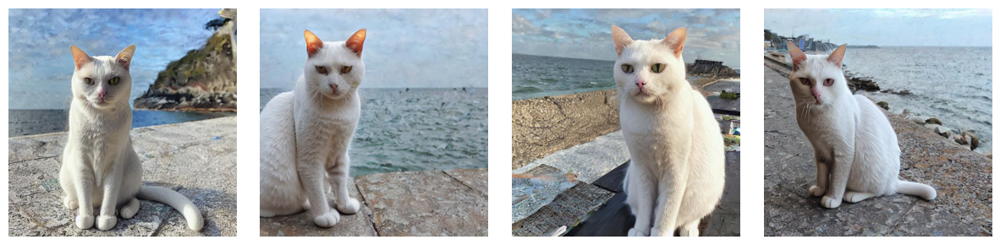

In [13]:
# variance_type = 'learned'
# negative_prompt = None
images_paths = list(paths.list_images('images_linear_learned_3e-06_1200/sea'))
plot_images(load_images(images_paths[:4]))

**negative_prompt**

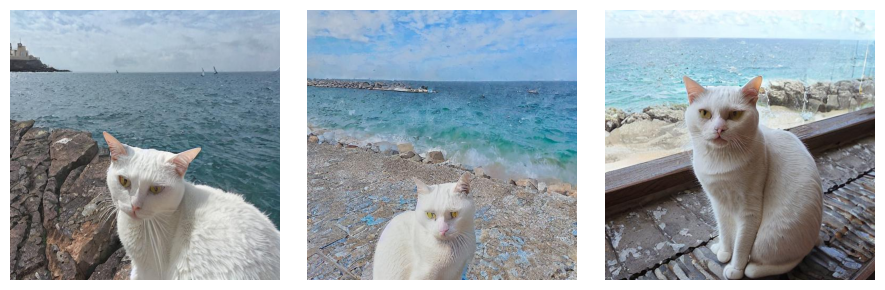

In [21]:
# variance_type = 'learned'
# with negative_prompt
images_paths = list(paths.list_images('images_linear_learned_3e-06_1200/sea_neg'))
plot_images(load_images(images_paths[:3]))

**different prompts**

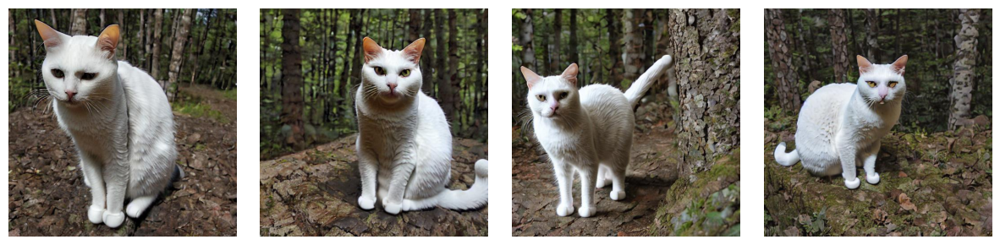

In [25]:
# variance_type = 'learned'
# negative_prompt = None
# prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} in the forest"
images_paths = list(paths.list_images('images_linear_learned_3e-06_1200/forest'))
plot_images(load_images(images_paths[:4]))

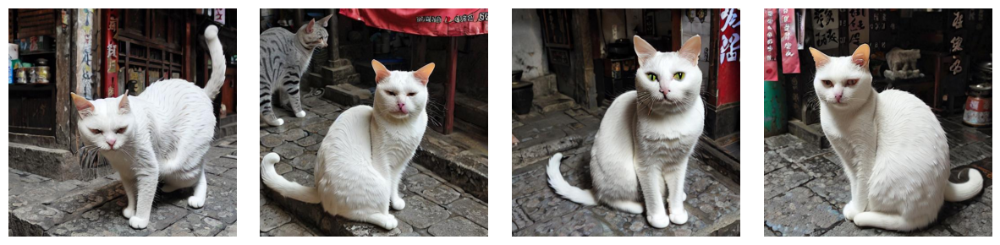

In [27]:
# variance_type = 'learned'
# negative_prompt = None
# prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} in Jiufen"
images_paths = list(paths.list_images('images_linear_learned_3e-06_1200/jiufen'))
plot_images(load_images(images_paths[:4]))

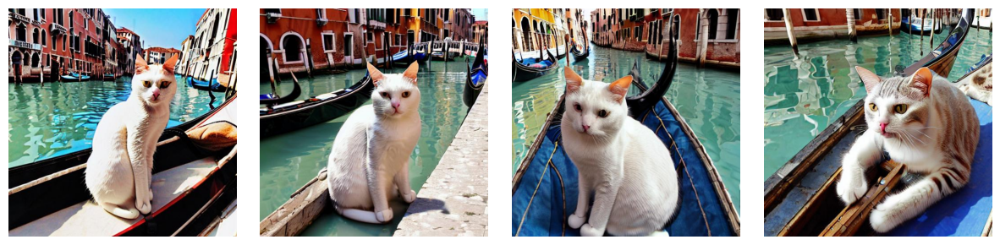

In [28]:
# variance_type = 'learned'
# negative_prompt = None
# prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} on a gondola in Venice"
images_paths = list(paths.list_images('images_linear_learned_3e-06_1200/venice'))
plot_images(load_images(images_paths[:4]))

Increasing the complexity of the prompt scene can also degrade image quality and instance fidelity.

## Tune Text Encoder

Tried different combinations of params, here is the result of setting: <br>
learning_rate = 2e-6 <br>
max_train_steps = 400 <br>
beta_schedule='linear'<br>
variance_type='learned'<br>
steps=50, ups=12 <br>
+wandb <br>
with different prompts


After tuning the text encoder, the diversity of the images has noticeably increased. Previously, using the prompt = f'a photo of {UNIQUE_ID} {CLASS_LABEL} by the sea' would simply produce an image of a cat by the sea. However, now the same prompt might generate more varied scenes.

Using a unique_id to generate instance images has increased the proportion of white cats, improving color fidelity compared to previous models. However, the fidelity of the physical appearance seems to have decreased, resulting in greater diversity in the cats' appearances.

### By the sea

prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} by the sea"

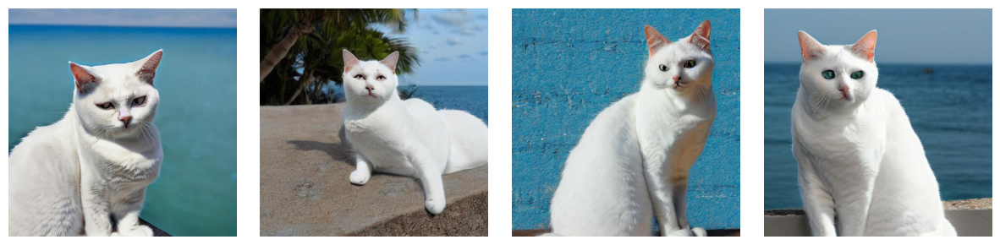

In [32]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/sea'))
plot_images(load_images(images_paths[:4]))

Using the same prompt, the images generated could be as simple as before, or they could be **a photo of** a cat by the sea, or a painting.

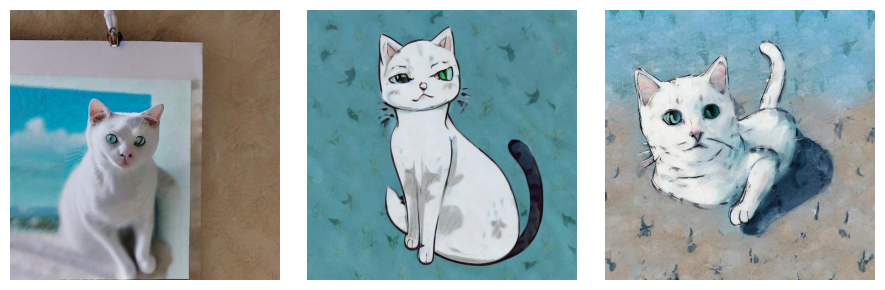

In [45]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/sea/like_painting'))
plot_images(load_images(images_paths[:3]))

Because a negative_prompt has not been set to restrict unwanted elements, multiple tails or broken tails still appear.

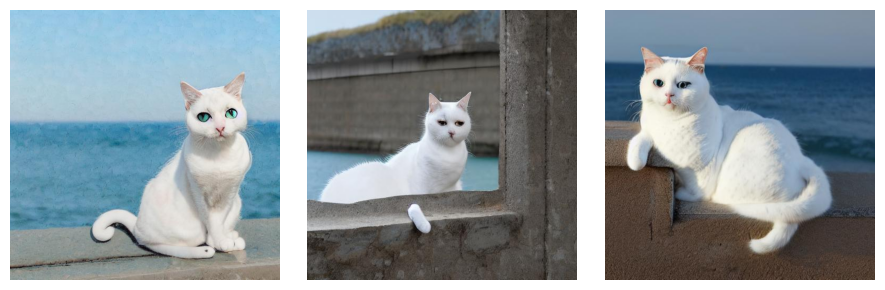

In [50]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/sea/multiple_parts'))
plot_images(load_images(images_paths[:3]))

Set **negative_prompt**. The image quality has decreased.

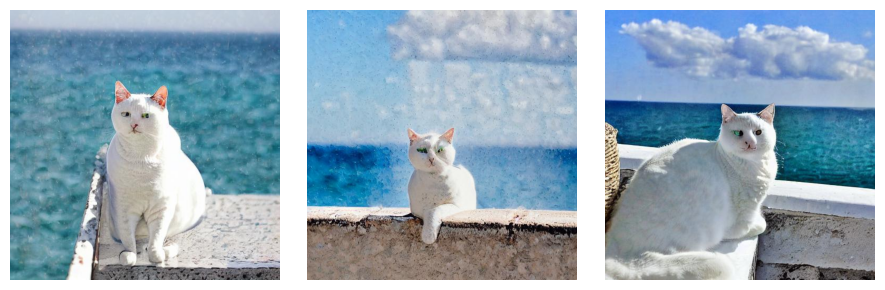

In [59]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/sea_neg'))
plot_images(load_images(images_paths[:3]))

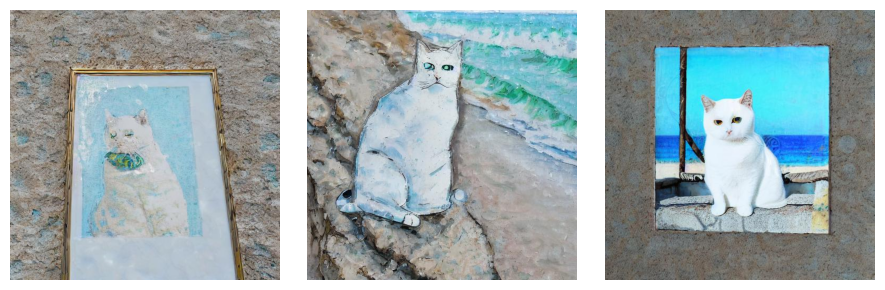

In [52]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/sea_neg/like_painting'))
plot_images(load_images(images_paths[:3]))

### In the forest

prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} in the forest"

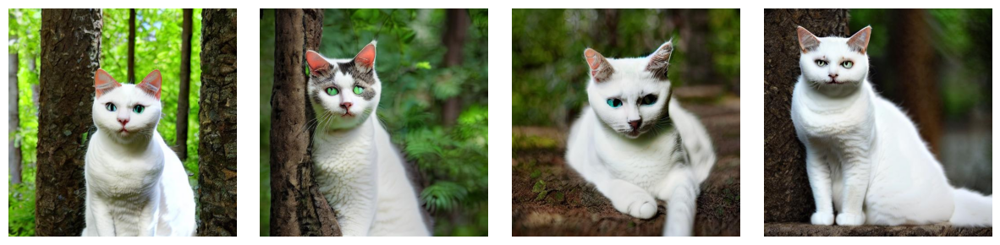

In [56]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/forest'))
plot_images(load_images(images_paths[:4]))

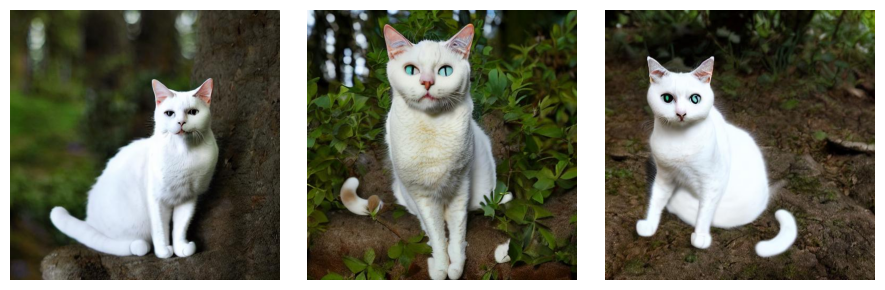

In [57]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/forest/multiple_parts'))
plot_images(load_images(images_paths[:3]))

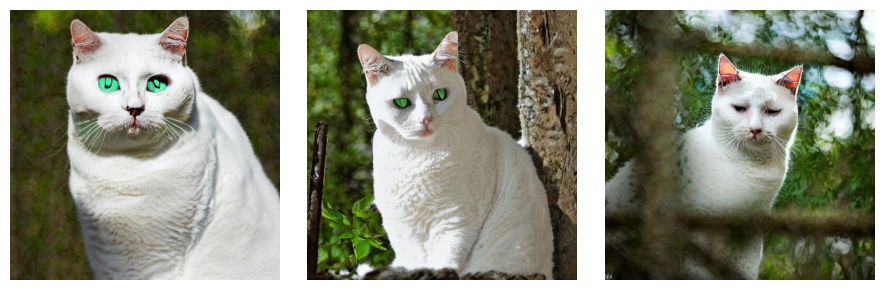

In [80]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/forest_neg'))
plot_images(load_images(images_paths[:3]))

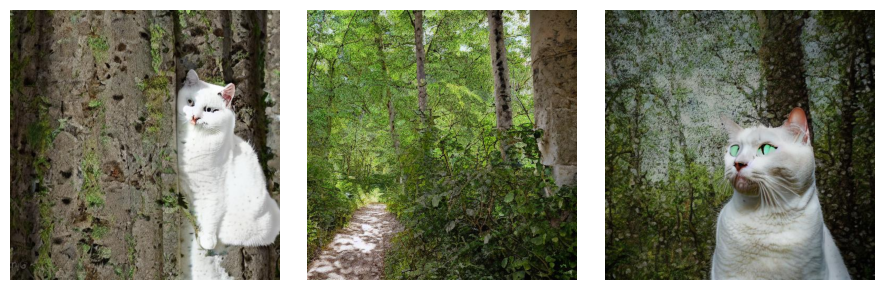

In [79]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/forest_neg/bad_quality'))
plot_images(load_images(images_paths[:3]))

### In Jiufen

prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} in Jiufen"

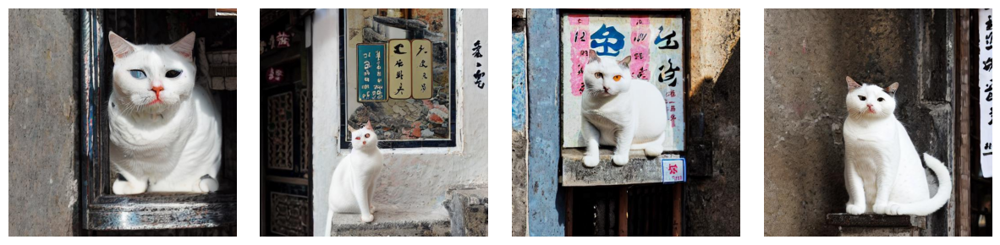

In [62]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/jiufen'))
plot_images(load_images(images_paths[:4]))

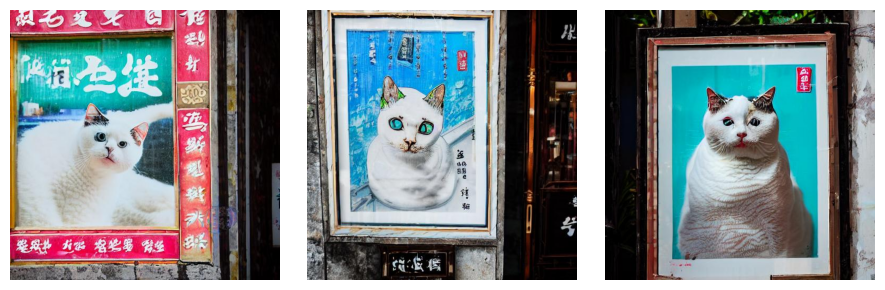

In [63]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/jiufen/like_poster'))
plot_images(load_images(images_paths[:3]))

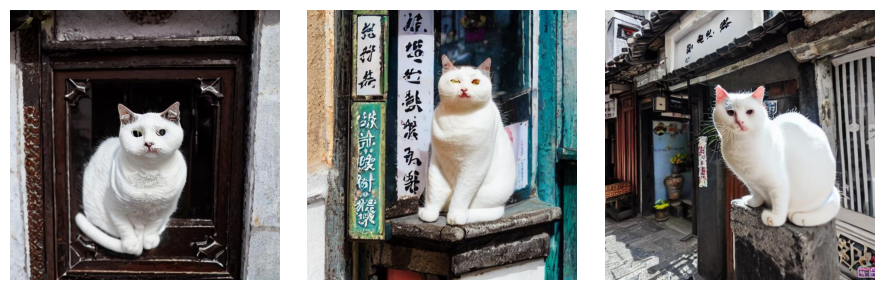

In [64]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/jiufen_neg'))
plot_images(load_images(images_paths[:3]))

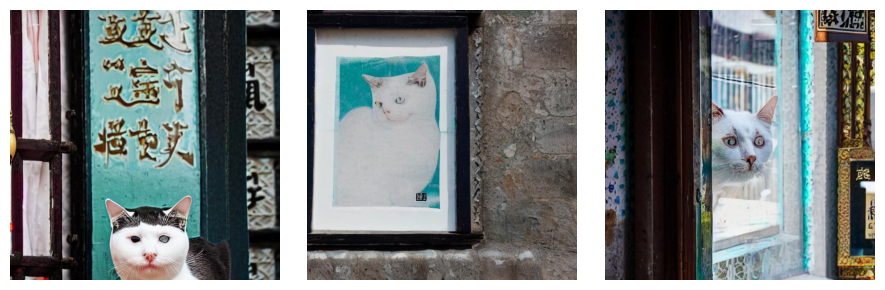

In [69]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/jiufen_neg/strange_images'))
plot_images(load_images(images_paths[:3]))

### In Venice

prompt = f"a photo of {UNIQUE_ID} {CLASS_LABEL} on a gondola in Venice"

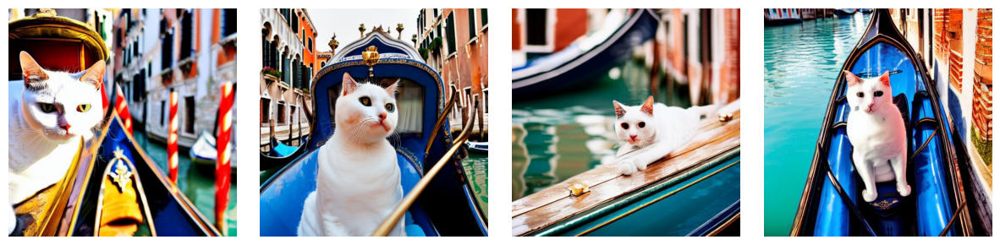

In [71]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/venice'))
plot_images(load_images(images_paths[:4]))

Increasing the complexity of the prompt scene may degrade image quality and instance fidelity. And sometimes the target cat disappears or becomes less prominent.

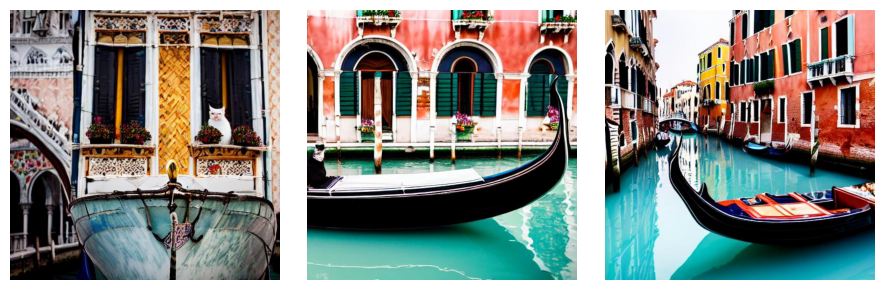

In [75]:
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/venice/strange_images'))
plot_images(load_images(images_paths[:3]))

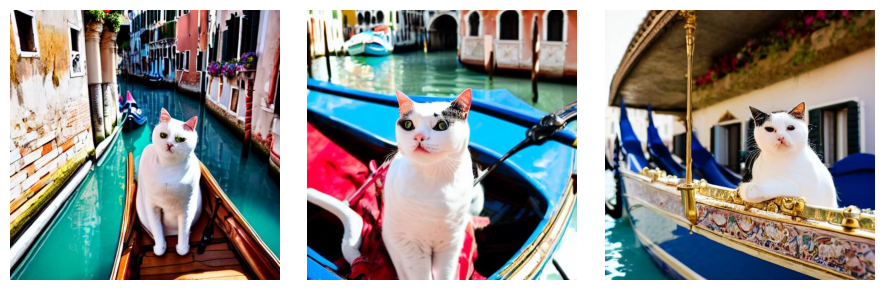

In [76]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/venice_neg'))
plot_images(load_images(images_paths[:3]))

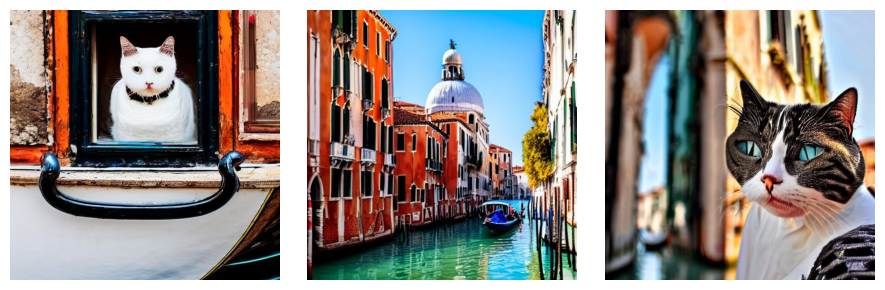

In [77]:
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/venice_neg/strange_images'))
plot_images(load_images(images_paths[:3]))

After tuning the model along with the text encoder, the quality and diversity of the images have noticeably increased. Previously, using the prompt 'a photo of miru cat by the sea' would simply produce an image of a cat by the sea. However, now the same prompt might generate more varied scenes; the images generated could be as simple as before, or they could be **a real photo of** a cat by the sea, or a painting.

Before using negative_prompt, issues such as multiple tails, legs, or incorrectly positioned tails occurred just as before; using negative_prompt improved these situations. As the complexity of the scene increased, sometimes the target becomes less prominent, which is similar to previous models.

The proportion of white cats has increased, improving color fidelity compared to previous models. However, the fidelity of the physical appearance seems to have decreased; the appearances of the cats are not always very similar to the target cat, showing greater variation, but they are all short-haired white cats.

### Cat to Dog

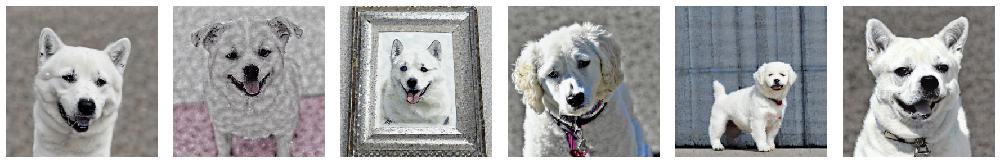

In [5]:
# prompt = f"a photo of {UNIQUE_ID} dog"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/dog'))
plot_images(load_images(images_paths[:6]))

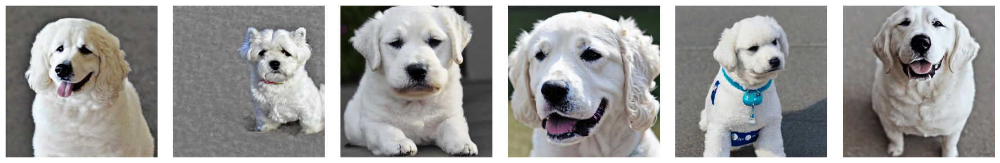

In [8]:
# prompt = f"a {UNIQUE_ID} dog"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/dog_2'))
plot_images(load_images(images_paths[:6]))

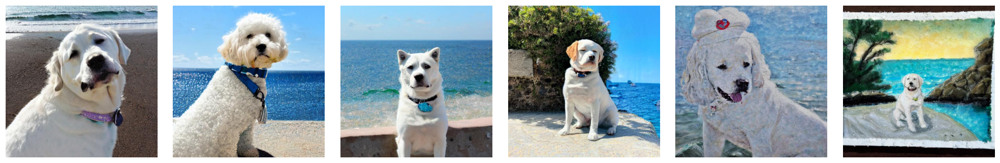

In [9]:
# prompt = f"a photo of {UNIQUE_ID} dog by the sea"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/dog_sea'))
plot_images(load_images(images_paths[:6]))

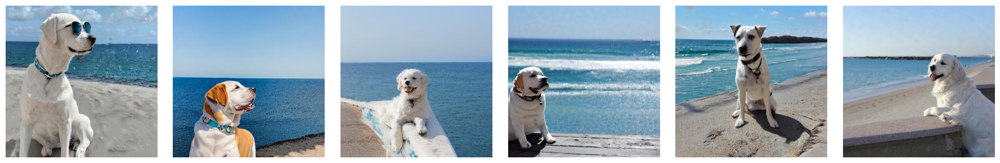

In [11]:
# prompt = f"a photo of {UNIQUE_ID} dog by the sea"
# with negative_prompt
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/dog_sea_neg'))
plot_images(load_images(images_paths[:6]))

### Cat to Boy

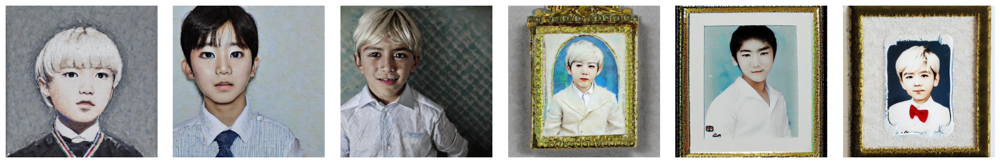

In [18]:
# prompt = f"A photo of {UNIQUE_ID} boy"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/boy'))
plot_images(load_images(images_paths[:6]))

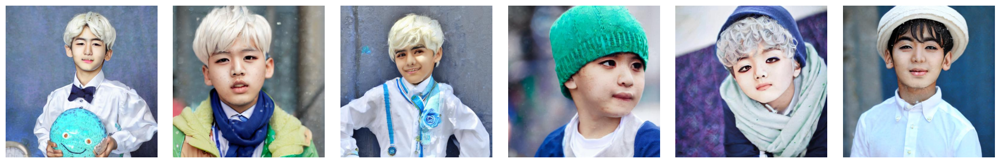

In [17]:
# prompt = f"A {UNIQUE_ID} boy"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/boy_2'))
plot_images(load_images(images_paths[:6]))

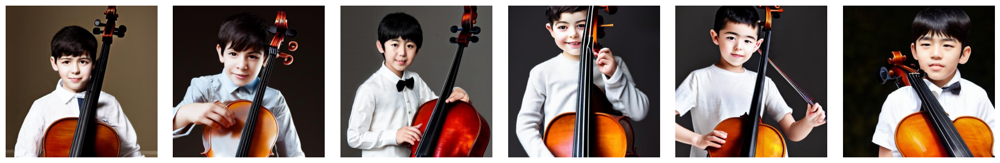

In [19]:
# prompt = f"a photo of a {UNIQUE_ID} boy plays the cello"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/boy_cell'))
plot_images(load_images(images_paths[:6]))

### Cat to man at a cafe in Cambridge

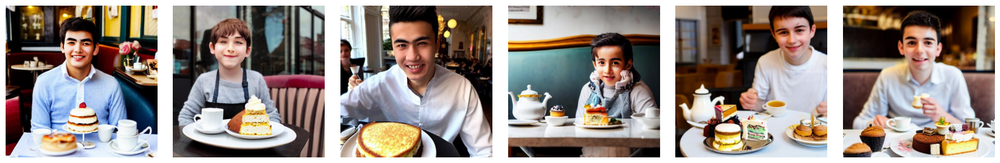

In [23]:
# prompt = f"a photo of a young {UNIQUE_ID} man is having afternoon tea with cake at a café in Cambridge"
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/young_man_cambridge_photo'))
plot_images(load_images(images_paths[:6]))

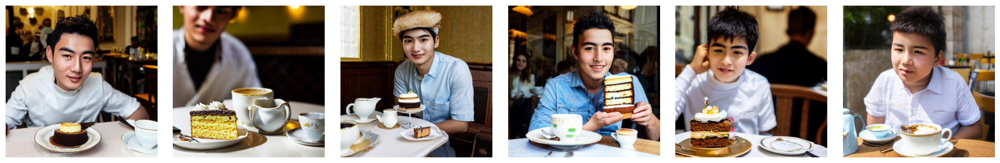

In [25]:
# prompt = f"a photo of a young {UNIQUE_ID} man is having afternoon tea with cake at a café in Cambridge"
# neg_prompt = 'multiple arms, multiple hands, multiple fingers'
images_paths = list(paths.list_images('images_2e-06_400_learned_textencoder/young_man_cambridge_photo_neg'))
plot_images(load_images(images_paths[:6]))